<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Visualization-Demo" data-toc-modified-id="Visualization-Demo-0.1"><span class="toc-item-num">0.1&nbsp;&nbsp;</span>Visualization Demo</a></span><ul class="toc-item"><li><span><a href="#Consider-data-in-2017-only" data-toc-modified-id="Consider-data-in-2017-only-0.1.1"><span class="toc-item-num">0.1.1&nbsp;&nbsp;</span>Consider data in 2017 only</a></span><ul class="toc-item"><li><span><a href="#Seasonality-Analysis" data-toc-modified-id="Seasonality-Analysis-0.1.1.1"><span class="toc-item-num">0.1.1.1&nbsp;&nbsp;</span>Seasonality Analysis</a></span></li><li><span><a href="#Distance,-Product-Volume-analysis" data-toc-modified-id="Distance,-Product-Volume-analysis-0.1.1.2"><span class="toc-item-num">0.1.1.2&nbsp;&nbsp;</span>Distance, Product Volume analysis</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#Lag-Time" data-toc-modified-id="Lag-Time-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Lag Time</a></span></li><li><span><a href="#Customer-States-&amp;-Seller-States" data-toc-modified-id="Customer-States-&amp;-Seller-States-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Customer States &amp; Seller States</a></span><ul class="toc-item"><li><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Visualization-for-Total-Delivery-Time-vs-Connection-between-cities" data-toc-modified-id="Visualization-for-Total-Delivery-Time-vs-Connection-between-cities-2.0.0.1"><span class="toc-item-num">2.0.0.1&nbsp;&nbsp;</span>Visualization for Total Delivery Time vs Connection between cities</a></span></li></ul></li></ul></li></ul></li><li><span><a href="#Payment-Type" data-toc-modified-id="Payment-Type-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Payment Type</a></span></li><li><span><a href="#Product-Volume" data-toc-modified-id="Product-Volume-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Product Volume</a></span></li><li><span><a href="#Product-Weight" data-toc-modified-id="Product-Weight-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Product Weight</a></span></li><li><span><a href="#Interaction-Weight---Volume" data-toc-modified-id="Interaction-Weight---Volume-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Interaction Weight - Volume</a></span></li><li><span><a href="#Historical-Mean-Seller-Time" data-toc-modified-id="Historical-Mean-Seller-Time-7"><span class="toc-item-num">7&nbsp;&nbsp;</span>Historical Mean Seller Time</a></span></li><li><span><a href="#Regional-differences-in-delivery-time" data-toc-modified-id="Regional-differences-in-delivery-time-8"><span class="toc-item-num">8&nbsp;&nbsp;</span>Regional differences in delivery time</a></span><ul class="toc-item"><li><span><a href="#Delivery-times-for-different-regions" data-toc-modified-id="Delivery-times-for-different-regions-8.1"><span class="toc-item-num">8.1&nbsp;&nbsp;</span>Delivery times for different regions</a></span></li><li><span><a href="#Income-per-capita" data-toc-modified-id="Income-per-capita-8.2"><span class="toc-item-num">8.2&nbsp;&nbsp;</span>Income per capita</a></span><ul class="toc-item"><li><span><a href="#Distribution-of-income-in-brazil" data-toc-modified-id="Distribution-of-income-in-brazil-8.2.1"><span class="toc-item-num">8.2.1&nbsp;&nbsp;</span>Distribution of income in brazil</a></span></li></ul></li></ul></li></ul></div>

1) rdpc - income
2) customer prefix postcode
3) mean total delivery time per seller_id
4) distance
5) connection_between_states
6) connection_between_cities
7) Intercation(connection_between_states, connection_between_cities)
8) season (dry/wet)
9) lag_time
10) seller_id_encoded


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model
import statsmodels.formula.api as sm
from statsmodels.tools.eval_measures import rmse
import scipy
sns.set()

In [2]:
import pandas as pd

def reformat_data(df=None):
    if df is not None:
        df = time_format(df)
        df = create_order_session(create_order_weekday(df))
        df = remove_geolocation_outliers(df)
        return df

def create_order_weekday(df=None):
    if df is None:
        return
    df['order_purchase_weekday'] = df['order_purchase_timestamp'].dt.day_name()
    df = df.assign(order_purchase_session=pd.cut(df.order_purchase_timestamp.dt.hour, [0, 6, 12, 18, 24],
                                                 labels=['Night', 'Morning', 'Afternoon', 'Evening'], right=False))
    return df


def create_order_session(df=None):
    if df is None:
        return
    df['order_purchase_timestamp'] =  pd.to_datetime(df['order_purchase_timestamp'], format='%Y/%m/%d %H:%M:%S')
    dry = [9, 10, 11, 12, 1, 2]
    wet = [3, 4, 5, 6, 7, 8]
    d = {**dict.fromkeys(dry, 'dry'), **dict.fromkeys(wet, 'wet')}
    df['seasons'] = list(map(d.get, df.order_purchase_timestamp.dt.month))
    return df

def calculate_time_difference_in_hour(data, col1, col2, target_col):
    data[target_col] = ((pd.to_datetime(data[col1]) - 
                            pd.to_datetime(data[col2]))
                                .dt.total_seconds() / (60 * 60))
    return

def time_format(data):
    '''
    Function to convert dataset time columns into pandas datetime and calculations for promise date,
    approval time and total time to deliver
    '''
    data.order_delivered_customer_date=pd.to_datetime(data.order_delivered_customer_date, errors='coerce',format='%Y-%m-%d %H:%M')
    data.order_purchase_timestamp = pd.to_datetime(data.order_purchase_timestamp,errors='coerce',format='%Y-%m-%d %H:%M')
    data.order_approved_at = pd.to_datetime(data.order_approved_at, errors='coerce',format='%Y-%m-%d %H:%M')
    data.order_estimated_delivery_date = pd.to_datetime(data.order_estimated_delivery_date, errors='coerce',format='%Y-%m-%d')
    data.order_delivered_customer_date = pd.to_datetime(data.order_delivered_customer_date, errors='coerce',format='%Y-%m-%d %H:%M')
    df.order_delivered_carrier_date = pd.to_datetime(data.order_delivered_carrier_date, errors='coerce',format='%Y-%m-%d %H:%M')
    data['promise_date'] = data.order_estimated_delivery_date >= data.order_delivered_customer_date  # True if product delivered before or at estimated delivery date
    calculate_time_difference_in_hour(data, 'order_approved_at', 'order_purchase_timestamp', 'approval_time')  # Time for buyer to approve sale
    #data['total_time_to_deliver'] = data.order_delivered_customer_date - data.order_purchase_timestamp  # total time from pruchase to delivery
    #data['actual_delivery_time'] = data.order_delivered_customer_date - data.order_delivered_carrier_date  # total time from pruchase to delivery
#     data['actual_delivery_time'] = (data['order_delivered_customer_date'] - data['order_delivered_carrier_date']).dt.total_seconds()/ (60 * 60)
#     data['total_delivery_time'] = (data['order_delivered_customer_date'] - data['order_purchase_timestamp']).dt.total_seconds()/ (60 * 60)
#     data['shipping_limit_date'] = pd.to_datetime(df.shipping_limit_date, errors='coerce', format='%Y-%m-%d %H:%M')
    return data

def remove_geolocation_outliers(data):
    # Removing some outliers 
    #Brazils most Northern spot is at 5 deg 16′ 27.8″ N latitude.;
    data = data[data.geolocation_lat <= 5.27438888]
    #it's most Western spot is at 73 deg, 58′ 58.19″W Long.
    data = data[data.geolocation_lng >= -73.98283055]
    #It's most southern spot is at 33 deg, 45′ 04.21″ S Latitude.
    data = data[data.geolocation_lat >= -33.75116944]
    #It's most Eastern spot is 34 deg, 47′ 35.33″ W Long.
    data = data[data.geolocation_lng <=  -34.79314722]
    return data

df = pd.read_csv('../../data/processed/20th_May_olist.csv' , dtype={'seller_zip_code_prefix': str, 'customer_zip_code_prefix': str})
df.set_index('order_id', inplace=True)
df = reformat_data(df)

In [3]:
df.seasons = df.seasons.astype('category')
df.payment_type = df.payment_type.astype('category')

In [4]:
# Remove all orders with invalid delivery time
df = df[df.total_delivery_time > df.actual_delivery_time]
df = df[df.actual_delivery_time > 0]

In [5]:
def encode_categorical_variable_by_delivery_time(data, target_col_name, asc=True, rev=False):
    df_cat_to_val = data.groupby(target_col_name).mean().reset_index().sort_values(by='total_delivery_time', ascending=asc)
    # Encode categorical val into numerical val
    encode_col_name = 'encode_' + target_col_name
    if rev:
        df_cat_to_val[encode_col_name] = np.linspace(1, df_cat_to_val.shape[0], df_cat_to_val.shape[0])
    else:
        df_cat_to_val[encode_col_name] = np.linspace(df_cat_to_val.shape[0], 1, df_cat_to_val.shape[0])
    df_cat_to_val = df_cat_to_val[[target_col_name, encode_col_name]]
    df_cat_to_val = df_cat_to_val.set_index(target_col_name)
    df_cat_to_val = df_cat_to_val.to_dict()
    # Map encoded vals into dataset
    new_target_col_name = target_col_name + '_encoded'
    data[new_target_col_name] = data[target_col_name].map(lambda x: df_cat_to_val[encode_col_name][x])
    
    return

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10410 entries, 000e562887b1f2006d75e0be9558292e to fffc94f6ce00a00581880bf54a75a037
Data columns (total 72 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   Unnamed: 0                             10410 non-null  int64         
 1   order_item_id                          10410 non-null  int64         
 2   product_id                             10410 non-null  object        
 3   seller_id                              10410 non-null  object        
 4   shipping_limit_date                    10410 non-null  object        
 5   price                                  10410 non-null  float64       
 6   freight_value                          10410 non-null  float64       
 7   customer_id                            10410 non-null  object        
 8   order_status                           10410 non-null  object        
 9   order_pu

## Visualization Demo

### Consider data in 2017 only

In [7]:
# Majority of orders were in 2017
def construct_dataset_2017_wrt_season(df=None):
    # df[0] -> dry data, df[1] -> wet data
    df_2017_dry, df_2017_wet = df[(df['order_purchase_timestamp'] >= '2017-Sep-01') & (df['order_purchase_timestamp'] <= '2018-Feb-28') & (df['seasons'] == 'dry')].sort_values(by='order_purchase_timestamp'), \
                                df[(df['order_purchase_timestamp'] >= '2017-Mar-01') & (df['order_purchase_timestamp'] <= '2017-Aug-31') & (df['seasons'] == 'wet')].sort_values(by='order_purchase_timestamp')
    return df_2017_dry, df_2017_wet

df_2017_dry, df_2017_wet = construct_dataset_2017_wrt_season(df)


#### Seasonality Analysis

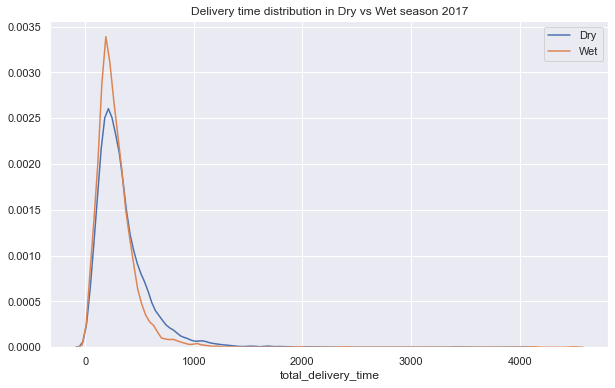

In [8]:
sns.set(rc={'figure.figsize':(10, 6)})

_ = sns.distplot(df_2017_dry['total_delivery_time'], hist=False, label='Dry')

_ = sns.distplot(df_2017_wet['total_delivery_time'], hist=False, label='Wet')

_ = plt.title('Delivery time distribution in Dry vs Wet season 2017')


##### Permutation test

In [9]:
# # Initialize necessary variables for permutation process
# N_replicates = 10000
# df_2017 = np.concatenate((df_2017_dry['total_delivery_time'], df_2017_wet['total_delivery_time']))
# x_bar = np.mean(df_2017_dry['total_delivery_time'])
# len_x = len(df_2017_dry['total_delivery_time'])
# y_bar = np.mean(df_2017_wet['total_delivery_time'])
# T_values = np.zeros(N_replicates) # test statistics of replicates are stored here

# # Define & compute test statistic
# T_observation = x_bar - y_bar

# # Perform permutation process
# for i in range(N_replicates):
#     # Generate permutation samples
#     permuted_data = np.random.permutation(df_2017)
#     sample_1, sample_2 = permuted_data[:len_x], permuted_data[len_x:]
#     # Calculate test statistic for replicate
#     T_values[i] = np.mean(sample_1) - np.mean(sample_2)

# # Plot histogram for test statistics
# _ = plt.hist(T_values, bins=50, normed=True)
# _ = plt.vlines(x=T_observation, ymin=0, ymax=0.2, color='red', label='Observed test statistic')
# _ = plt.title('Permutation test for the mean difference of total delivery time between Dry vs Wet season')

# # Compute the p value
# print('p-value=', np.sum(abs(T_values) >= T_observation) / len(T_values))

#### Distance, Product Volume analysis

<center>$\textbf{Product Category}$</center>

In [10]:
# Encode product_category_name_english categorical variable
encode_categorical_variable_by_delivery_time(df, 'product_category_name_english', asc=True, rev=False)

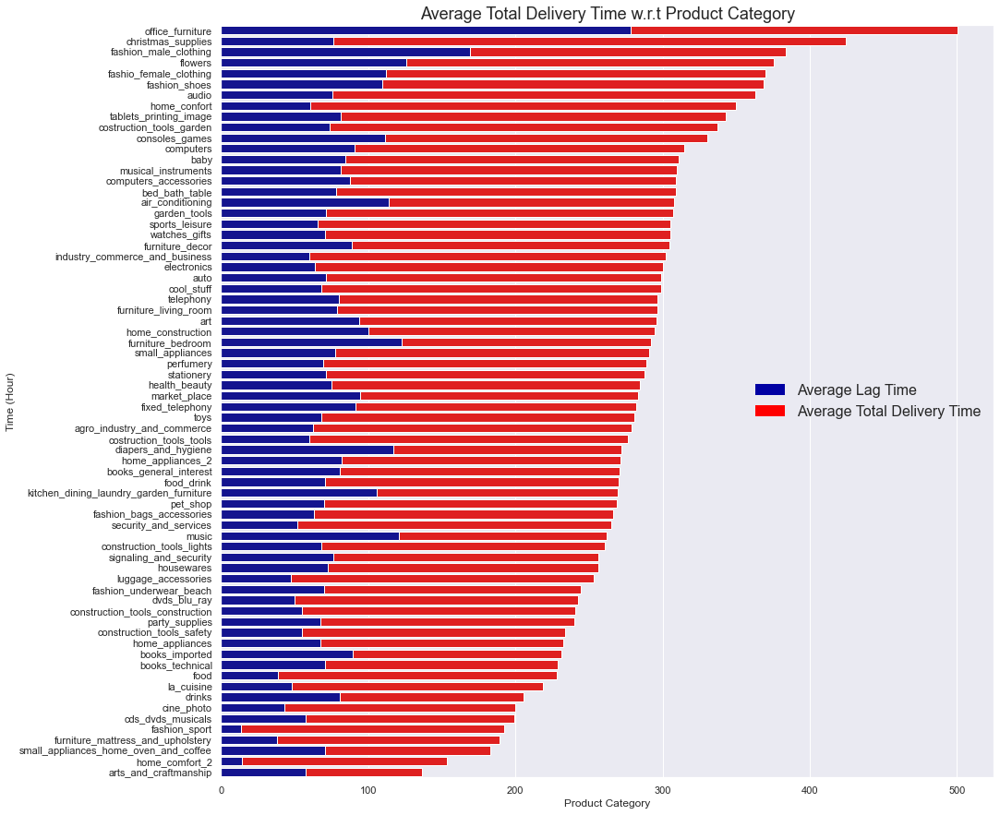

In [11]:
# Plot top 15 product cats that have highest delivery time
# Material is from https://randyzwitch.com/creating-stacked-bar-chart-seaborn/
df_2017_grp_product_cat = df.groupby('product_category_name_english').mean()
df_2017_grp_product_cat = df_2017_grp_product_cat.reset_index()
df_2017_grp_product_cat = df_2017_grp_product_cat.sort_values(by='total_delivery_time', ascending=False)

sns.set(rc={'figure.figsize':(15, 15)})
topbar = plt.Rectangle((0,0),1,1,fc="red", edgecolor = 'none')
bottombar = plt.Rectangle((0,0),1,1,fc='#0000A3',  edgecolor = 'none')
l = plt.legend([bottombar, topbar], ['Average Lag Time', 'Average Total Delivery Time'], loc=5, ncol = 1, prop={'size':16})
l.draw_frame(False)

_ = sns.barplot(data=df_2017_grp_product_cat[:], y='product_category_name_english', x='total_delivery_time', color = "red")
_ = sns.barplot(data=df_2017_grp_product_cat[:], y='product_category_name_english', x='lag_time', color='#0000A3')
_ = plt.xlabel('Product Category')
#_ = plt.xticks(rotation=45)
_ = plt.ylabel('Time (Hour)')
_ = plt.title('Average Total Delivery Time w.r.t Product Category', fontsize=18)

It seems that office_furniture takes longer time to deliver due to manufacturing process usually requires a large amount of time

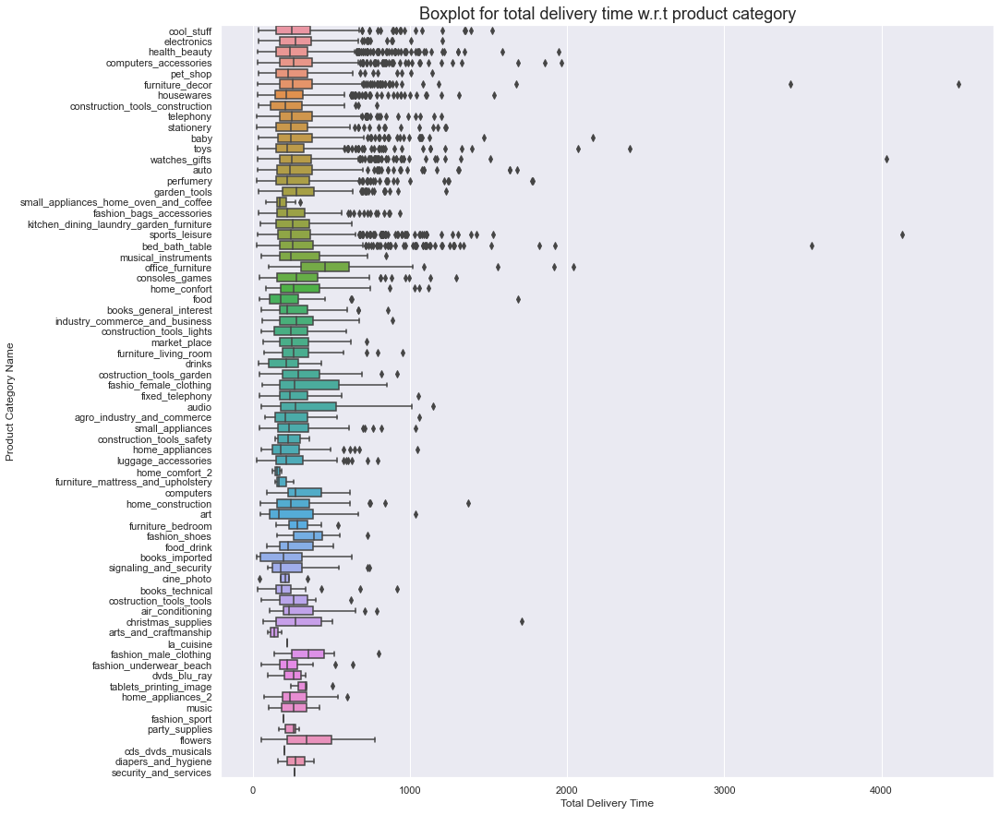

In [12]:
sns.set(rc={'figure.figsize':(15, 15)})
_ = sns.boxplot(data=df, y='product_category_name_english', x='total_delivery_time')
_ = plt.xlabel('Total Delivery Time')
_ = plt.ylabel('Product Category Name')
_ = plt.title('Boxplot for total delivery time w.r.t product category', fontsize=18)

It seems that the variation in total delivery time is high w.r.t product category and the presence of outliers is also significant<br>
=> Try to examine the standard deviation of total delivery time by product category to see what we can conclude

In [13]:
df_2017_grp_product_cat_std = df.groupby('product_category_name_english').std()
df_2017_grp_product_cat_std = df_2017_grp_product_cat_std.reset_index()


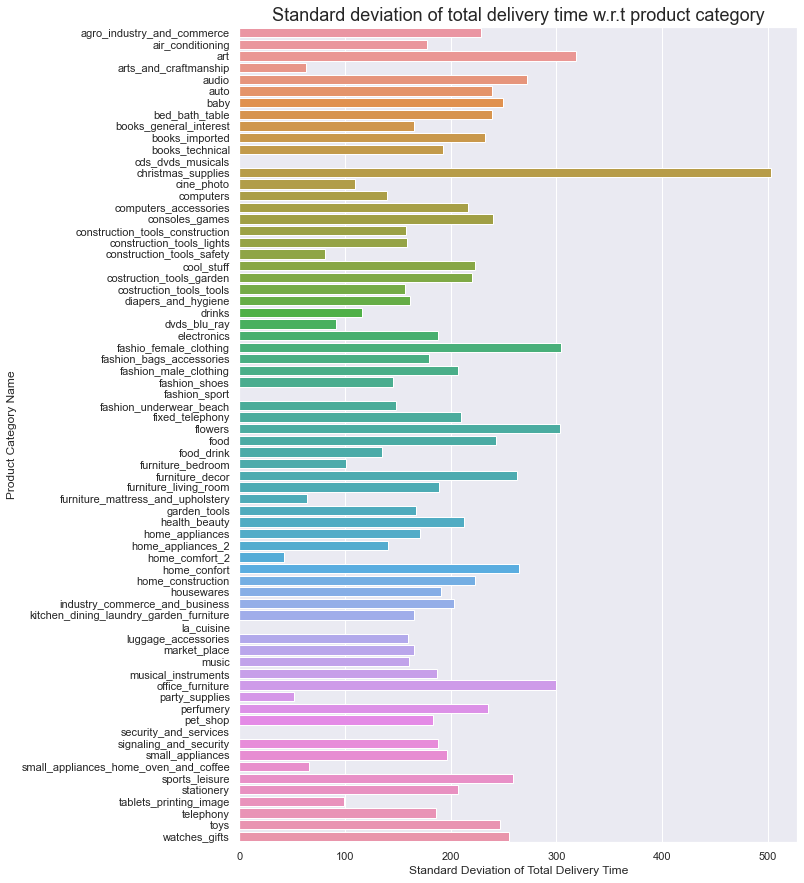

In [14]:
sns.set(rc={'figure.figsize':(10, 15)})
_ = sns.barplot(data=df_2017_grp_product_cat_std, y='product_category_name_english', x='total_delivery_time')
_ = plt.xlabel('Standard Deviation of Total Delivery Time')
_ = plt.ylabel('Product Category Name')
_ = plt.title('Standard deviation of total delivery time w.r.t product category', fontsize=18)

The majority of product categories have high std of total delivery time; precisely, the std of total delivery time in general is above 100 hours ~ 4 days, which means it is hard to find any signature pattern for total delivery time w.r.t product category.

$\textbf{Average Delivery Time for each state}$

In [15]:
df_2017_grp_state = df.groupby('customer_state').mean()
df_2017_grp_state = df_2017_grp_state.reset_index()
df_2017_grp_state = df_2017_grp_state.sort_values(by='total_delivery_time', ascending=True)

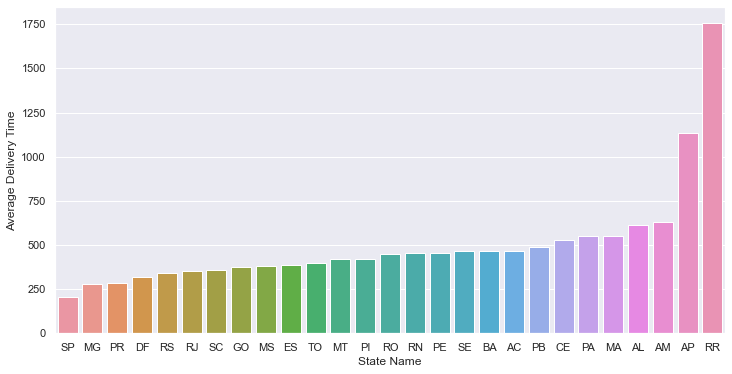

In [16]:
sns.set(rc={'figure.figsize':(12, 6)})

_ = sns.barplot(data=df_2017_grp_state, x='customer_state', y='total_delivery_time')
_ = plt.xlabel('State Name')
_ = plt.ylabel('Average Delivery Time')

The more popular a state is, the lower delivery time would be. This could be due to the fact that there are many metropolises with well-developed transportation infrastructure and large market share within those states. Therefore, Olist focuses more on those states compared to other states. 

$\textbf{Delivery Time distribution}$

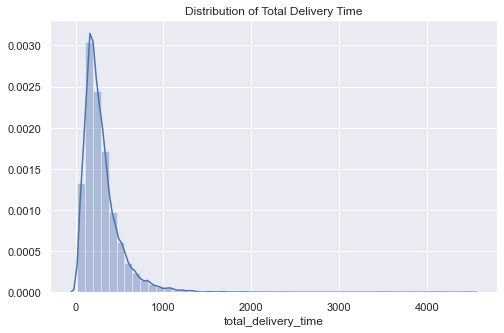

In [17]:
sns.set(rc={'figure.figsize':(8, 5)})

_ = sns.distplot(df['total_delivery_time'])
_ = plt.title('Distribution of Total Delivery Time')

The total delivery time scattered around 200. However, it has an unusual long tail, which extends to 5000 hours and the reason for this will be taken into consideration in the following analysis.

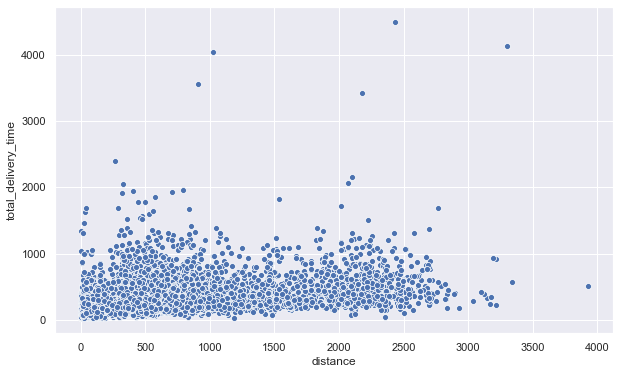

In [18]:
sns.set(rc={'figure.figsize':(10, 6)})
_ = sns.scatterplot(data=df, x='distance', y='total_delivery_time')

=> Distance is NOT a problem since even the distance is nearly 0, the time it takes to deliver is still more than 10000 <br>
Or the data tells that the skyway distance should not be a good indicator for the total delivery time.

# Lag Time

Lag time = Time when products are dispatched to carriers - Time when customer ordered products

In [19]:
calculate_time_difference_in_hour(df, 'order_delivered_carrier_date', 'order_purchase_timestamp', 'lag_time')

Number of orders having lag time more than 50% of total delivery time:  1879
Number of orders having lag time less than 50% of total delivery time:  8531


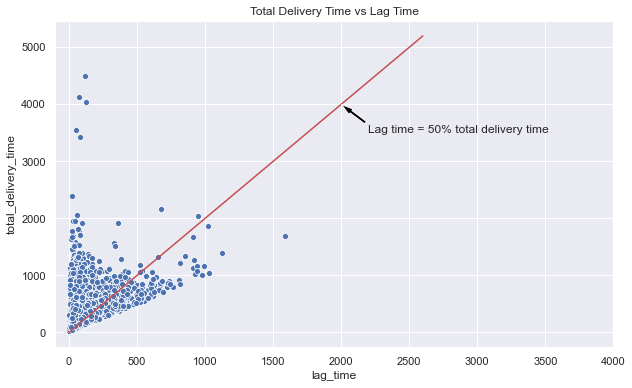

In [20]:
sns.set(rc={'figure.figsize':(10, 6)})
_ = sns.scatterplot(data=df, x='lag_time', y='total_delivery_time')
_ = plt.xlim(-100, 4000)
_ = plt.plot([0, 2600], [0, 5200], color='r')
_ = plt.annotate('Lag time = 50% total delivery time', xy=(2000,4000), xytext=(2000+200, 3500),
             arrowprops=dict(facecolor='black', shrink=0.01, headwidth=7, width=3))
_ = plt.title('Total Delivery Time vs Lag Time')

lag_time_more_than_50_percent = len(df[df.total_delivery_time * 0.5 <= df.lag_time])
lag_time_less_than_50_percent = len(df[df.total_delivery_time * 0.5 > df.lag_time])
print('Number of orders having lag time more than 50% of total delivery time: ', lag_time_more_than_50_percent)
print('Number of orders having lag time less than 50% of total delivery time: ', lag_time_less_than_50_percent)

About 21.7% number of orders having issue with lag time. Thus, this might also be the reason for long delivery time; however, it is not actually the root cause.

# Customer States & Seller States

In [21]:
df_states = df.groupby(['customer_state', 'seller_state']).mean()
df_states = df_states['total_delivery_time'].reset_index()

In [22]:
df_states_pivot = df_states.pivot(index='customer_state', columns='seller_state', values='total_delivery_time').fillna(0)

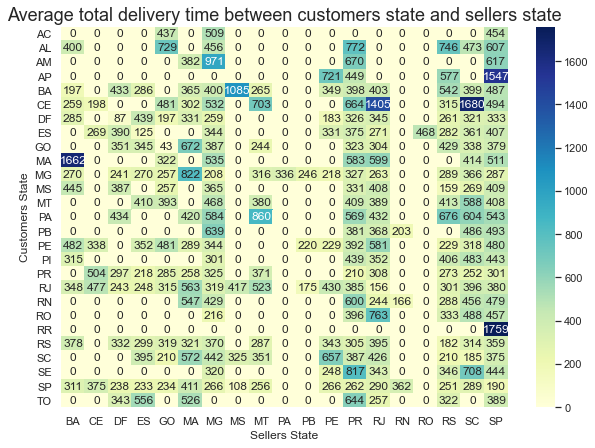

In [23]:
sns.set(rc={'figure.figsize':(10, 7)})
# Source: https://www.justintodata.com/how-to-use-python-seaborn-for-exploratory-data-analysis/
_ = sns.heatmap(df_states_pivot, annot=True, fmt='.0f', cmap="YlGnBu")
_ = plt.title('Average total delivery time between customers state and sellers state', fontsize=18)
_ = plt.xlabel('Sellers State')
_ = plt.ylabel('Customers State')

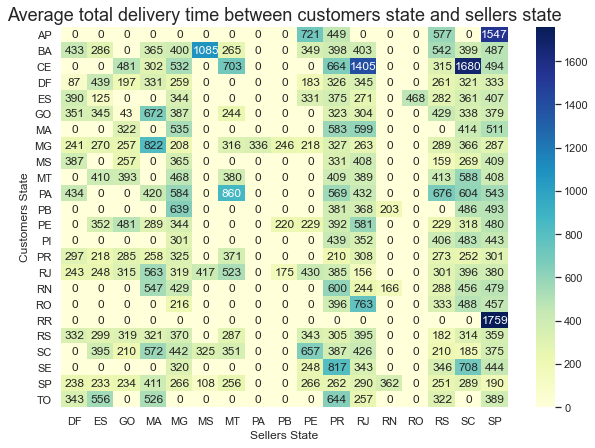

In [24]:
df_state_no_outliers = df[((df.customer_state != 'AC') & (df.seller_state != 'BA')) & \
                             ((df.customer_state != 'AL') & (df.seller_state != 'AM')) & \
                             ((df.customer_state != 'AM') & (df.seller_state != 'CE'))]
df_state_no_outliers = df_state_no_outliers.groupby(['customer_state', 'seller_state']).mean()
df_state_no_outliers = df_state_no_outliers['total_delivery_time'].reset_index()
df_state_no_outliers_pivot = df_state_no_outliers.pivot(index='customer_state', columns='seller_state', values='total_delivery_time').fillna(0)

_ = sns.heatmap(df_state_no_outliers_pivot, annot=True, fmt='.0f', cmap="YlGnBu")
_ = plt.title('Average total delivery time between customers state and sellers state', fontsize=18)
_ = plt.xlabel('Sellers State')
_ = plt.ylabel('Customers State')

There are many pairs of customer state & seller state that have high distance BUT their average delivery times are against the logic! => This could lead to 2 possible explanations:
1. The calculation of distance is wrong.
2. There might be some underlying factors that have not been discovered.<br>

*** For the distance calculation, we compute the skyway distance between 2 points so this must be the lower bound of the real distance. However, the skyway distance of, say, pair A is lower than that of pair B does not mean that real distance of pair A is gonna be lower than that of pair B. 
<br><br>
However, this data gives us a more reliable sense of knowing how long the delivery time between 2 particular states should be rather than considering skyway distance between 2 states only. This is because of the fact that the average delivery time between 2 states are historical data and it is unbiased to the way we compute it in comparison with the evaluation of distance, whose results are biased in the way of calculation.

$\textbf{New Feature: Connection between 2 states}$<br>

Based on the analysis above, we could construct a new feature called Connection Between Two States, which displays by a numerical value to represent the degree of connection between 2 states, so the higher degree of connection is, the lower delivery time between those 2 states

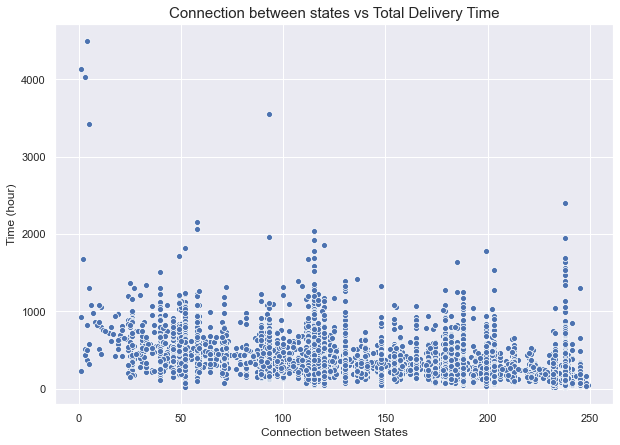

In [25]:
_ = sns.scatterplot(data=df, x='connection_between_states', y='total_delivery_time')
_ = plt.title('Connection between states vs Total Delivery Time', fontsize=15)
_ = plt.xlabel('Connection between States')
_ = plt.ylabel('Time (hour)')

<center> $\textbf{Customer City & Seller City}$ </center>

$\textbf{New Feature: Connection between 2 cities}$

#### Visualization for Total Delivery Time vs Connection between cities

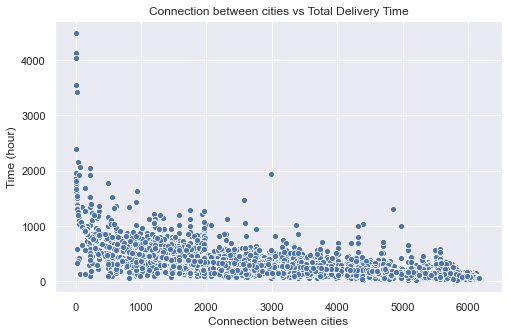

In [26]:
sns.set(rc={'figure.figsize':(8, 5)})

_ = sns.scatterplot(data=df, x='connection_between_cities', y='total_delivery_time')
_ = plt.title('Connection between cities vs Total Delivery Time')
_ = plt.xlabel('Connection between cities')
_ = plt.ylabel('Time (hour)')

It seems to have a linear relationship but there are many outliers for the total delivery time and this makes the visualization become harder -> try to do log transformation for the delivery time to see is there anything happen

/Users/dylanho/opt/anaconda3/envs/myenv/lib/python3.8/site-packages/seaborn/regression.py:573: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


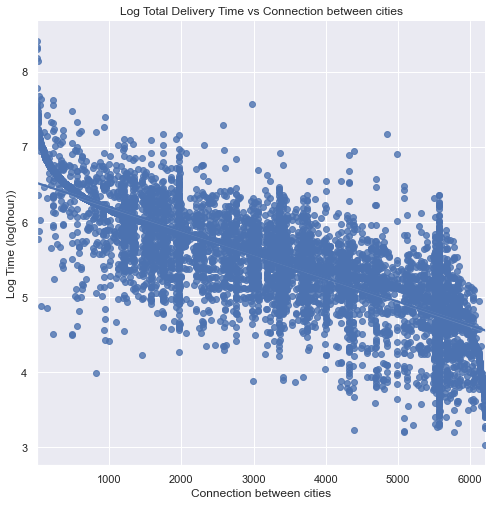

In [27]:
#sns.set(rc={'figure.figsize':(10, 6)})
_ = sns.lmplot(data=df, x='connection_between_cities', y='total_delivery_time_log', order=1, size=7)
_ = plt.title('Log Total Delivery Time vs Connection between cities')
_ = plt.xlabel('Connection between cities')
_ = plt.ylabel('Log Time (log(hour))')

=> Log distance gives a better visualization wrt delivery time

Since each pair of cities is encoded by a number and its magnitude is proportional to the reciprocal of delivery time. That means, the higher value assigned to a pair of cities, the less delivery time it would have.

By looking at the graph above, it seems to follow our expectation, in which the higher degree of connection between cities, the lower delivery time should be.

# Payment Type

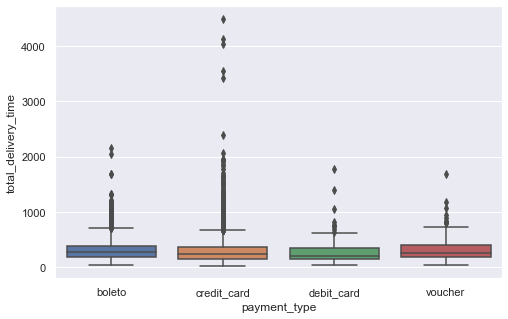

In [28]:
sns.boxplot(y = 'total_delivery_time',x  = 'payment_type', data = df)

[Text(0, 0.5, 'log_total_delivery_time')]

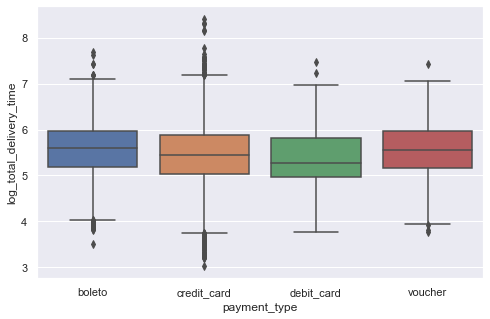

In [29]:
sns.boxplot(y = np.log(df.total_delivery_time),x  = 'payment_type', data = df).set(ylabel = 'log_total_delivery_time')

([<matplotlib.patches.Wedge at 0x1273e4070>,
 [Text(-0.8593412086889277, 0.8375754814039466, 'credit_card'),
  Text(0.6851341252566355, -0.8605761037867744, 'boleto'),
  Text(1.084104645997209, -0.1863252976041264, 'voucher'),
  Text(1.0989177604152909, -0.048782741249765435, 'debit_card')],
 [Text(-0.5012823717352078, 0.4885856974856354, '75.4%'),
  Text(0.3737095228672557, -0.4694051475200587, '20.6%'),
  Text(0.5913298069075685, -0.10163198051134166, '2.6%'),
  Text(0.5994096874992495, -0.026608767954417505, '1.4%')])

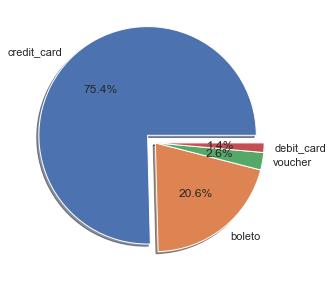

In [30]:
p1 = sum(df.payment_type == 'credit_card')
p2 = sum(df.payment_type == 'boleto')
p3 = sum(df.payment_type == 'voucher')
p4 = sum(df.payment_type == 'debit_card')

p_type_sizes = [p1,p2,p3,p4]
p_type_labels = 'credit_card','boleto','voucher','debit_card'
plt.pie(p_type_sizes, explode = (0.1,0,0,0), labels = p_type_labels,autopct='%1.1f%%',shadow=True)

[Text(0, 0.5, 'log_total_delivery_time')]

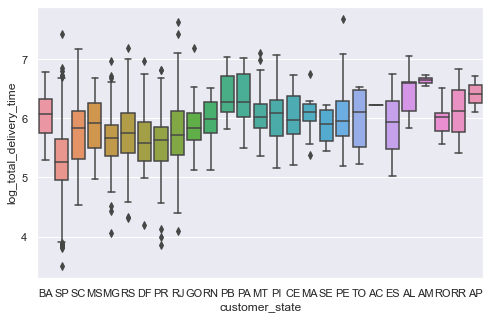

In [31]:
sns.boxplot(y = np.log(df.total_delivery_time),x  = 'customer_state', data = df[df.payment_type == 'boleto']).set(ylabel = 'log_total_delivery_time')

[Text(0, 0.5, 'log_total_delivery_time')]

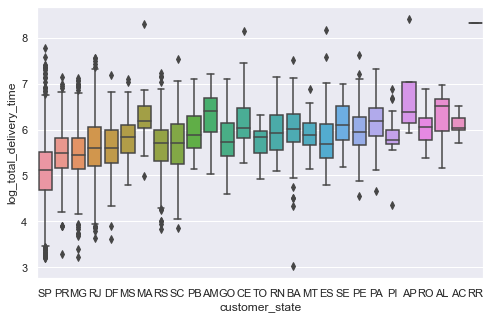

In [32]:
sns.boxplot(y = np.log(df.total_delivery_time),x  = 'customer_state', data = df[df.payment_type == 'credit_card']).set(ylabel = 'log_total_delivery_time')

# Product Volume

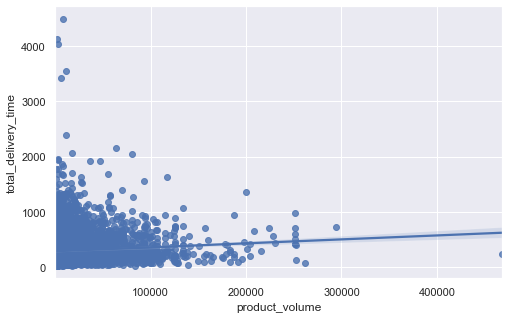

In [33]:
sns.regplot(y = 'total_delivery_time', x = 'product_volume', data = df)

[Text(0, 0.5, 'log_total_delivery_time')]

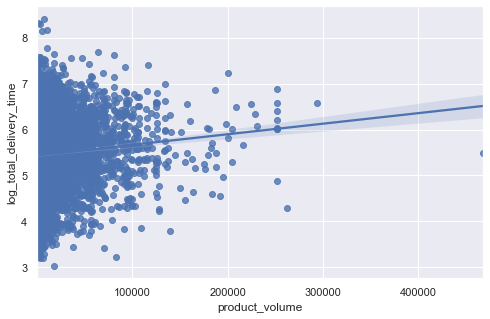

In [34]:
sns.regplot(y = np.log(df.total_delivery_time), x = 'product_volume', data = df).set(ylabel = 'log_total_delivery_time')

[Text(0, 0.5, 'log_total_delivery_time')]

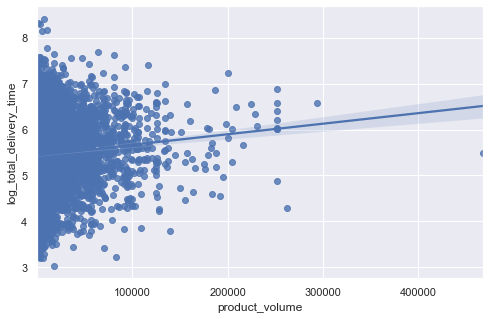

In [35]:
sns.regplot(y = np.log(df[df.product_volume <600000].total_delivery_time), x = 'product_volume', data = df[df.product_volume <600000]).set(ylabel = 'log_total_delivery_time')

[Text(0, 0.5, 'log_total_delivery_time')]

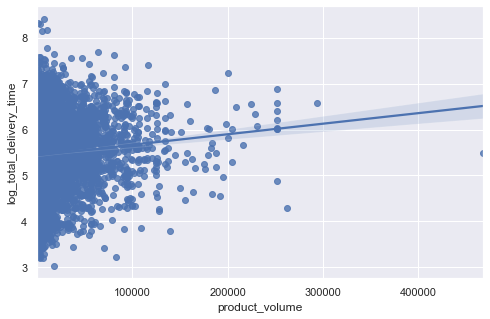

In [36]:
sns.regplot(y = np.log(df[df.product_volume <500000].total_delivery_time), x = 'product_volume', data = df[df.product_volume <500000]).set(ylabel = 'log_total_delivery_time')

# Product Weight

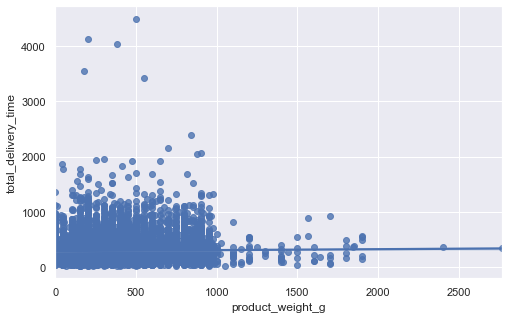

In [37]:
sns.regplot(y = 'total_delivery_time', x = 'product_weight_g', data = df)

[Text(0, 0.5, 'log_total_delivery_time')]

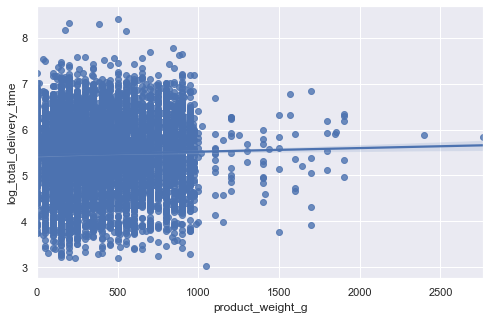

In [38]:
sns.regplot(y = np.log(df.total_delivery_time), x = 'product_weight_g', data = df).set(ylabel = 'log_total_delivery_time')

[Text(0, 0.5, 'log_total_delivery_time')]

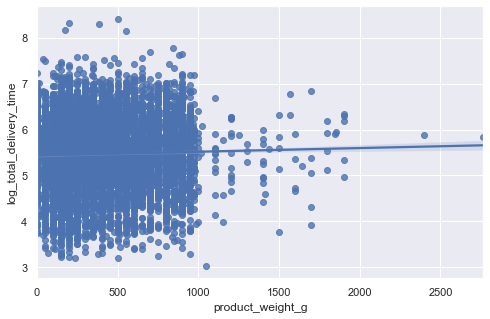

In [39]:
sns.regplot(y = np.log(df[df.product_weight_g <=6000].total_delivery_time), x = 'product_weight_g', data = df[df.product_weight_g <=6000]).set(ylabel = 'log_total_delivery_time')

# Interaction Weight - Volume

In [40]:
df = pd.read_csv("../../data/processed/20th_May_olist.csv")
df['product_volume_bin'] = pd.DataFrame(range(0,len(df)+1))
df["log_total_delivery_time"] = np.log(df.total_delivery_time)

In [41]:
for i in range(0,len(df)):
    if df.product_volume[i] <= 10000:
        df.product_volume_bin[i] = "10k"
    elif df.product_volume[i] <=20000 and df.product_volume[i] >10000:
        df.product_volume_bin[i] = "20k"
    elif df.product_volume[i] <=30000 and df.product_volume[i] >20000:
        df.product_volume_bin[i] = "30k"
    elif df.product_volume[i] <=40000 and df.product_volume[i] >30000:
        df.product_volume_bin[i] = "40k"
    else:
        df.product_volume_bin[i] = '>40k'

<ipython-input-41-eb98b5397db3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.product_volume_bin[i] = "10k"
/Users/dylanho/opt/anaconda3/envs/myenv/lib/python3.8/site-packages/pandas/core/indexing.py:671: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(indexer, value)
<ipython-input-41-eb98b5397db3>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.product_volume_bin[i] = "20k"
<ipython-input-41-eb98b53

/Users/dylanho/opt/anaconda3/envs/myenv/lib/python3.8/site-packages/seaborn/regression.py:573: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


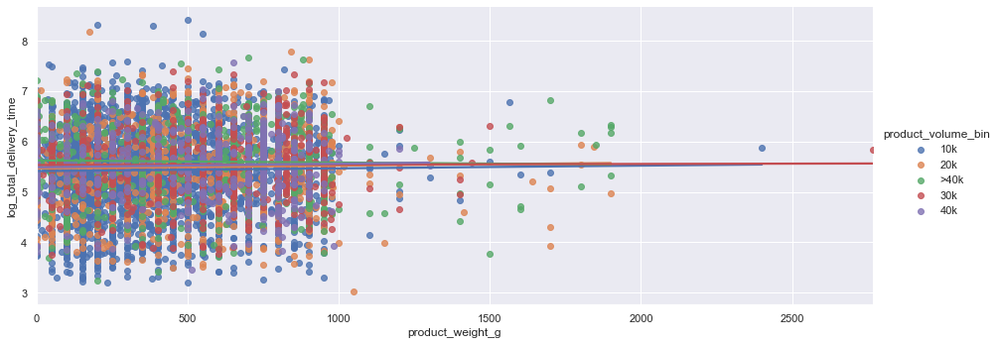

In [42]:
sns.lmplot(x='product_weight_g', y='log_total_delivery_time', hue='product_volume_bin', data = df[df.product_weight_g <=8000], ci=None, size=5, aspect=2.5)

In [43]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
import plotly.express as px
import numpy as np

df['product_volumetric_weight_log'] = np.log(df['product_volumetric_weight'])

df['freight_ratio'] = df['freight_value']/df['product_volumetric_weight_log']
df['order_purchase_timestamp'] =  pd.to_datetime(df['order_purchase_timestamp'], format='%Y/%m/%d')

df.replace([np.inf, -np.inf], np.nan).dropna(axis=1)

/Users/dylanho/opt/anaconda3/envs/myenv/lib/python3.8/site-packages/pandas/core/series.py:679: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


,Unnamed: 0,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,customer_id,order_status,...,product_category_name_english_encoded,connection_between_states,connection_between_cities,zip_2_prefix,rdpc,zip_2_prefix_cat,seller_delivery_PrevMean,product_volume_bin,log_total_delivery_time,freight_ratio
0,0,000e562887b1f2006d75e0be9558292e,1,5ed9eaf534f6936b51d0b6c5e4d5c2e9,8cbac7e12637ed9cffa18c7875207478,28/02/2018 12:08,25.00,16.11,2b01d668726fb0b751c55918c0437b7b,delivered,...,25.0,185,1215,9,689.21,9,438.866667,10k,6.084196,1.295309
1,1,0015ebb40fb17286bea51d4607c4733c,1,50fd2b788dc166edd20512370dac54df,8b321bb669392f5163d04c59e235e066,18/01/2018 9:11,21.90,15.10,da43a556bf5c36a1104c473cff77de6c,delivered,...,23.0,179,1191,83,824.97,83,443.466667,10k,6.094623,1.464746
2,2,001862358bf858722e1e2ae000cfed8b,1,c6dd917a0be2a704582055949915ab32,7a67c85e85bb2ce8582c35f2203ad736,13/02/2018 19:10,99.99,13.72,2cf869dd40c98f29686f636d83545cce,delivered,...,25.0,238,2943,10,525.19,10,219.766667,20k,5.392566,1.221702
3,3,001ab0a7578dd66cd4b0a71f5b6e1e41,1,0b0172eb0fd18479d29c3bc122c058c2,5656537e588803a555b8eb41f07a944b,4/01/2018 2:33,24.89,17.63,8bb3bef4e75a95524235cdc11a7331af,delivered,...,23.0,77,1567,38,973.00,38,524.083333,10k,6.261651,1.714374
4,4,001e7cf2ad6bef3ade12ebc56ceaf0f3,1,bdcf6a834e8faa30dac3886c7a58e92e,2a84855fd20af891be03bc5924d2b453,22/05/2018 10:59,35.90,15.20,d1684ed69f8fd574b7c344de923f379a,delivered,...,34.0,233,1559,36,753.35,36,391.650000,20k,5.970369,1.213436
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10405,10405,ffea79d8c5fecc22cbff0c54eda9b65c,1,ea44caac707f7f1325182a538007f838,855668e0971d4dfd7bef1b6a4133b41b,12/09/2017 4:24,50.00,19.59,bbef00095c712ca0e62584d68cb9fdfa,delivered,...,13.0,52,1580,46,205.18,46,388.066667,40k,5.961177,1.486218
10406,10406,ffebd80e3291e811c308365936897efd,1,4cc4d02efc8f249c13355147fb44e34d,d1c7fa84e48cfa21a0e595167c1c500e,18/07/2018 20:23,129.90,51.20,050309b91cc5e04e68841938e7984aaf,delivered,...,18.0,178,3632,26,614.57,26,239.666667,10k,5.479249,4.219004
10407,10407,ffeeb911d070bea3dd20bd5fd01da5e8,1,a5341e3f8155dbb3e62323d3ea289729,ff063b022a9a0aab91bad2c9088760b7,13/10/2017 19:25,79.50,16.19,c580ed6ed2fe3533df6af1dcb43bac94,delivered,...,21.0,238,1121,10,826.02,10,455.116667,10k,6.120554,1.333475
10408,10408,fffb9224b6fc7c43ebb0904318b10b5f,4,43423cdffde7fda63d0414ed38c11a73,b1fc4f64df5a0e8b6913ab38803c57a9,3/11/2017 2:55,55.00,34.19,4d3abb73ceb86353aeadbe698aa9d5cb,delivered,...,20.0,33,863,54,407.34,54,506.833333,10k,6.228182,3.138170


In [44]:
tp = df.groupby(["product_category_name_english","seasons"])[["freight_ratio"]].mean().reset_index()

fig = px.treemap(tp, path=["product_category_name_english","seasons"], values='freight_ratio',
                  color='freight_ratio', hover_data=['product_category_name_english'],
                  color_continuous_scale='rainbow')
fig.show()

# Historical Mean Seller Time

In [45]:
df_filtered = df.copy()
df_filtered['seller_ids'] = pd.factorize(df_filtered['seller_id'])[0]

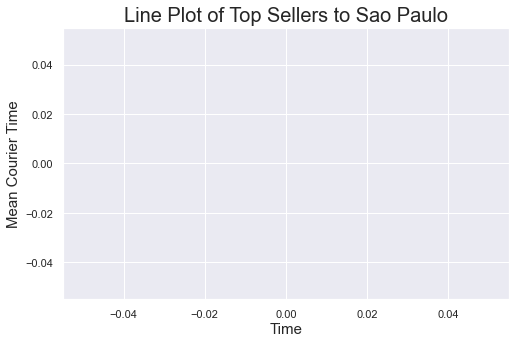

In [46]:
df_sellers1 = df_filtered[(df_filtered['seller_ids']==174) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='sao paulo')]
df_sellers2 = df_filtered[(df_filtered['seller_ids']==52) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='sao paulo')]
df_sellers3 = df_filtered[(df_filtered['seller_ids']==22) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='sao paulo')]
df_sellers4 = df_filtered[(df_filtered['seller_ids']==37) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='sao paulo')]
df_sellers5 = df_filtered[(df_filtered['seller_ids']==176) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='sao paulo')]


sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers1)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers2)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers3)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers4)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers5)

plt.title("Line Plot of Top Sellers to Sao Paulo", fontsize = 20) # for title
plt.xlabel("Time", fontsize = 15) # label for x-axis
plt.ylabel("Mean Courier Time", fontsize = 15) # label or y-axis
plt.show()

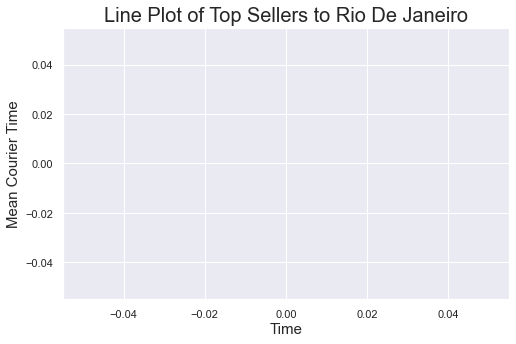

In [47]:
df_sellers1 = df_filtered[(df_filtered['seller_ids']==174) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='rio de janeiro')]
df_sellers2 = df_filtered[(df_filtered['seller_ids']==52) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='rio de janeiro')]
df_sellers3 = df_filtered[(df_filtered['seller_ids']==22) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='rio de janeiro')]
df_sellers4 = df_filtered[(df_filtered['seller_ids']==37) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='rio de janeiro')]
df_sellers5 = df_filtered[(df_filtered['seller_ids']==176) & (df_filtered['seller_city']=='sao paulo') & (df_filtered['customer_city']=='rio de janeiro')]


sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers1)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers2)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers3)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers4)
sns.lineplot(x='order_purchase_timestamp', y='seller_delivery_PrevMean', data=df_sellers5)

plt.title("Line Plot of Top Sellers to Rio De Janeiro", fontsize = 20) # for title
plt.xlabel("Time", fontsize = 15) # label for x-axis
plt.ylabel("Mean Courier Time", fontsize = 15) # label for y-axis
plt.show()

# Regional differences in delivery time

Loading BokehJS ...

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
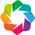

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
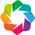

In [48]:
import pandas as pd

import holoviews as hv
import geoviews as gv
import datashader as ds
from colorcet import fire
from holoviews.streams import RangeXY
from holoviews.operation.datashader import datashade, dynspread, rasterize
from bokeh.io import output_notebook
from bokeh.plotting import figure, show
output_notebook()
hv.extension('bokeh')
import geopandas as gpd
import geoviews as gv
import geoviews.feature as gf
from geoviews import opts
from datashader.utils import lnglat_to_meters as webm
gv.extension('bokeh', 'matplotlib')

In [49]:
#Group postcodes for aggregations latter and only select buyer's data
data_buyer=df[['customer_zip_code_prefix','geolocation_lat', 'geolocation_lng','total_delivery_time']]
data_buyer['zip_2_prefix'] = data_buyer['customer_zip_code_prefix'].astype(str).str[0:2].astype(int)
data_buyer['zip_3_prefix'] = data_buyer['customer_zip_code_prefix'].astype(str).str[0:3].astype(int)
data_buyer['zip_4_prefix'] = data_buyer['customer_zip_code_prefix'].astype(str).str[0:4].astype(int)

# create geopandas dataframe from data_buyer
buyer_gpd=gpd.GeoDataFrame(data_buyer,geometry=gpd.points_from_xy(data_buyer.geolocation_lng, data_buyer.geolocation_lat))

<ipython-input-49-b559eafb471e>:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-49-b559eafb471e>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-49-b559eafb471e>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



## Delivery times for different regions

In [50]:
grouped=buyer_gpd.groupby('zip_3_prefix').mean()
grouped=gpd.GeoDataFrame(grouped,geometry=gpd.points_from_xy(grouped.geolocation_lng, grouped.geolocation_lat))
grouped=grouped.reset_index()
df_merged=buyer_gpd.merge(grouped[['zip_3_prefix','total_delivery_time']],on='zip_3_prefix',how='inner')

In [51]:
from datashader.utils import lnglat_to_meters as webm
x, y = webm(df_merged.geolocation_lng, df_merged.geolocation_lat)
df_merged['x'] = pd.Series(x)
df_merged['y'] = pd.Series(y)


In [52]:
%opts Overlay [width=800 height=600 toolbar='above' xaxis=None yaxis=None]
%opts QuadMesh [tools=['hover'] colorbar=True] (alpha=0 hover_alpha=0.2)
T = 0.05
PX = 5


url="http://server.arcgisonline.com/ArcGIS/rest/services/Canvas/World_Dark_Gray_Base/MapServer/tile/{Z}/{Y}/{X}.png"
geomap = gv.WMTS(url)
points = hv.Points(gv.Dataset(pd.DataFrame(df_merged), kdims=['x', 'y'], vdims=['total_delivery_time_y']))
agg = datashade(points, element_type=gv.Image, aggregator=ds.mean('total_delivery_time_y'), cmap=fire)
zip_codes = dynspread(agg, threshold=T, max_px=PX)

hover = hv.util.Dynamic(rasterize(points, aggregator=ds.mean('total_delivery_time_y'), width=50, height=25, streams=[RangeXY]), operation=hv.QuadMesh)
hover = hover.options(cmap=fire)
img=geomap*zip_codes*hover
img

:DynamicMap   []
   :Overlay
      .WMTS.I     :WMTS   [Longitude,Latitude]
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (total_delivery_time_y)

There is a clear difference in delivery times between the regions. The south is much quicker than the north. Lets break it down by region

In [53]:
north=['AC','AP','AM','PA','RO','RR']
northeast=['AL','BA','CE','MA','PB','PE','PI','RN','SE']
center_west=['DF','GO','MT','MS']
south=['PR','RS','SC']
southeast=['ES','MG','RJ']

In [54]:
#Get summary stats for all regions
df2=[]
names=['north','northeast','center_west','south','southeast']
for idx,i in enumerate([north,northeast,center_west,south,southeast]):
    df2.append(pd.DataFrame(pd.Series(df[df.customer_state.isin(i)].total_delivery_time.describe(),name=names[idx])))
pd.concat(df2,axis=1).round(2)

,north,northeast,center_west,south,southeast
count,166.00,972.00,606.00,1525.00,2765.00
mean,585.76,484.42,363.76,324.01,322.88
std,490.42,285.14,193.71,191.81,226.53
min,105.10,20.72,37.53,26.82,25.28
25%,358.75,312.78,224.72,192.85,187.30
50%,487.73,416.52,316.05,285.05,265.18
75%,683.59,584.51,442.25,396.25,381.30
max,4492.87,4033.98,1325.38,1859.37,3556.18


In [55]:
regions={
    'North':['AC','AP','AM','PA','RO','RR','TO'],
    'Northeast':['AL','BA','CE','MA','PB','PE','PI','RN','SE'],
    'Central West':['DF','GO','MT','MS'],
    'South':['PR','RS','SC'],
    'Southeast':['ES','MG','RJ','SP']
}

In [56]:
def invert_dict(d): 
    inverse = dict() 
    for key in d: 
        # Go through the list that is saved in the dict:
        for item in d[key]:
            # Check if in the inverted dict the key exists
            if item not in inverse: 
                # If not create a new list
                inverse[item] = key
            else: 
                inverse[item].append(key) 
    return inverse

In [57]:
regions=invert_dict(regions)
df['Region']=df.customer_state.map(regions)

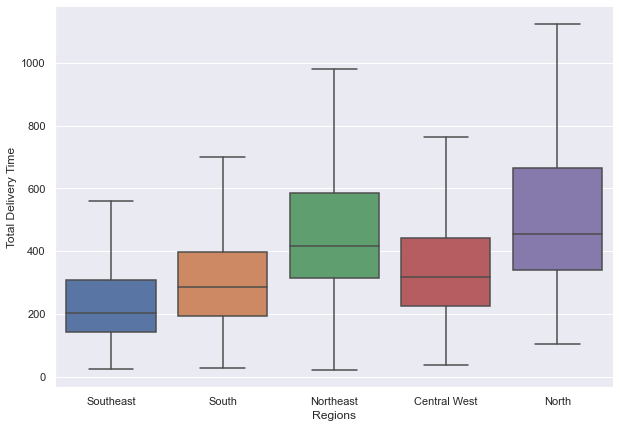

In [58]:
plt.figure(figsize=(10,7))
ax = sns.boxplot(x="Region", y="total_delivery_time", data=df,showfliers=False)

ax.set(xlabel='Regions', ylabel='Total Delivery Time')

sns.despine()

## Income per capita

Lets see if we can explain some of the regional variation be looking at income.

In [59]:
#Import 2010 census data
census=pd.read_csv('../../data/raw/atlas.csv')
census=census[census.ano==2010]
# Import geometry data for census
brazil=gpd.read_file('../../data/raw/BR_Localidades_2010.shp')
brazil['code_id_7']=pd.to_numeric(brazil['CD_GEOCODI'].str[0:7])
brazil_grouped=gpd.GeoDataFrame(brazil.groupby('code_id_7').mean())
brazil_grouped['geometry']=gpd.points_from_xy(brazil_grouped.LONG,brazil_grouped.LAT)
brazil_grouped.reset_index(inplace=True)

In [60]:
#merged geometric data with census
census_merged=gpd.GeoDataFrame(census.merge(brazil_grouped,left_on='codmun7',right_on='code_id_7'))
# Get regions of brazil
shape=gpd.read_file('../../data/raw/BRA_adm2.shp')
#only retain right geometry
census_merged=gpd.sjoin(census_merged,shape,how='right',op='within')
census_merged=census_merged.dropna(subset=['ano'])

/Users/dylanho/opt/anaconda3/envs/myenv/lib/python3.8/site-packages/geopandas/tools/sjoin.py:58: UserWarning:

CRS of frames being joined does not match!(None != epsg:4326)



### Distribution of income in brazil

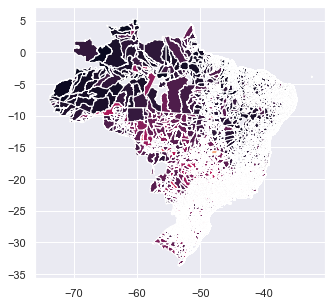

In [61]:
# Income data only
income=census_merged[['município','rdpc','geometry']]
income.plot(column='rdpc')


Lets add income data to the image above

In [62]:
income_plot=gv.Polygons(income, vdims='rdpc',
           ).opts(
                        width=800, height=600,
                        color_index='rdpc',
                        colorbar=True,
                        line_width=0
                       ) 

img2=income_plot*zip_codes*hover
img2

:DynamicMap   []
   :Overlay
      .Polygons.I :Polygons   [Longitude,Latitude]   (rdpc)
      .RGB.I      :RGB   [x,y]   (R,G,B,A)
      .QuadMesh.I :QuadMesh   [x,y]   (total_delivery_time_y)